In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
from IPython.display import display

In [3]:
df = pd.read_csv("../data/raw/processed_mobifall.csv")

In [4]:
df

,timestamp,acc_x,acc_y,acc_z,gyr_x,gyr_y,gyr_z,subject,trial,age,height,weight,gender,category,activity
0,1970-01-01 00:02:59.346219,1.130063,11.817780,-0.383072,-3.768428,-0.953866,-0.553749,sub4,1,32,186,93,M,ADL,WAL
1,1970-01-01 00:02:59.349906,1.127694,11.815442,-0.381362,-3.628845,-0.895528,-0.386983,sub4,1,32,186,93,M,ADL,WAL
2,1970-01-01 00:02:59.350795,1.125325,11.813104,-0.379651,-3.474601,-0.706771,-0.308487,sub4,1,32,186,93,M,ADL,WAL
3,1970-01-01 00:02:59.351241,1.122956,11.810765,-0.377941,-3.318220,-0.344223,-0.295353,sub4,1,32,186,93,M,ADL,WAL
4,1970-01-01 00:02:59.354893,1.120587,11.808427,-0.376230,-3.174361,0.103236,-0.286801,sub4,1,32,186,93,M,ADL,WAL
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2364830,1970-01-01 02:55:05.189187,0.880756,9.149267,0.568708,-0.031154,0.024435,0.022297,sub30,3,47,172,90,M,FALLS,BSC
2364831,1970-01-01 02:55:05.194178,0.880466,9.148878,0.569163,-0.038179,0.017410,0.020159,sub30,3,47,172,90,M,FALLS,BSC
2364832,1970-01-01 02:55:05.199176,0.880176,9.148489,0.569617,-0.029627,0.021075,0.020769,sub30,3,47,172,90,M,FALLS,BSC
2364833,1970-01-01 02:55:05.204459,0.879885,9.148101,0.570071,-0.019853,0.021686,0.014661,sub30,3,47,172,90,M,FALLS,BSC


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2364835 entries, 0 to 2364834
Data columns (total 15 columns):
 #   Column     Dtype  
---  ------     -----  
 0   timestamp  object 
 1   acc_x      float64
 2   acc_y      float64
 3   acc_z      float64
 4   gyr_x      float64
 5   gyr_y      float64
 6   gyr_z      float64
 7   subject    object 
 8   trial      int64  
 9   age        int64  
 10  height     int64  
 11  weight     int64  
 12  gender     object 
 13  category   object 
 14  activity   object 
dtypes: float64(6), int64(4), object(5)
memory usage: 270.6+ MB


In [6]:
# Set timestamp as index
df.index = pd.to_datetime(df['timestamp'])

In [7]:
del df['timestamp']

In [8]:
df

,acc_x,acc_y,acc_z,gyr_x,gyr_y,gyr_z,subject,trial,age,height,weight,gender,category,activity
timestamp,,,,,,,,,,,,,,
1970-01-01 00:02:59.346219,1.130063,11.817780,-0.383072,-3.768428,-0.953866,-0.553749,sub4,1,32,186,93,M,ADL,WAL
1970-01-01 00:02:59.349906,1.127694,11.815442,-0.381362,-3.628845,-0.895528,-0.386983,sub4,1,32,186,93,M,ADL,WAL
1970-01-01 00:02:59.350795,1.125325,11.813104,-0.379651,-3.474601,-0.706771,-0.308487,sub4,1,32,186,93,M,ADL,WAL
1970-01-01 00:02:59.351241,1.122956,11.810765,-0.377941,-3.318220,-0.344223,-0.295353,sub4,1,32,186,93,M,ADL,WAL
1970-01-01 00:02:59.354893,1.120587,11.808427,-0.376230,-3.174361,0.103236,-0.286801,sub4,1,32,186,93,M,ADL,WAL
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1970-01-01 02:55:05.189187,0.880756,9.149267,0.568708,-0.031154,0.024435,0.022297,sub30,3,47,172,90,M,FALLS,BSC
1970-01-01 02:55:05.194178,0.880466,9.148878,0.569163,-0.038179,0.017410,0.020159,sub30,3,47,172,90,M,FALLS,BSC
1970-01-01 02:55:05.199176,0.880176,9.148489,0.569617,-0.029627,0.021075,0.020769,sub30,3,47,172,90,M,FALLS,BSC


In [9]:
# Group the data by subject, category, activity and trial
grouped = df.groupby(['subject', 'category', 'activity', 'trial'])

# Now you can iterate through each subgroup
for name, group in grouped:
    subject, category, activity, trial = name
    print(f"Subject: {subject}, Category: {category}, Activity: {activity}, Trial: {trial}")
    print("Number of samples:", len(group))
    print("Start time:", group.index.min())
    print("End time:", group.index.max())
    print("-" * 40)

Subject: sub1, Category: FALLS, Activity: BSC, Trial: 1
Number of samples: 1999
Start time: 1970-01-01 02:41:26.116714
End time: 1970-01-01 02:41:36.106763
----------------------------------------
Subject: sub1, Category: FALLS, Activity: BSC, Trial: 2
Number of samples: 1999
Start time: 1970-01-01 02:41:36.111834
End time: 1970-01-01 02:41:46.101745
----------------------------------------
Subject: sub1, Category: FALLS, Activity: BSC, Trial: 3
Number of samples: 1999
Start time: 1970-01-01 02:41:46.106762
End time: 1970-01-01 02:41:56.096740
----------------------------------------
Subject: sub1, Category: FALLS, Activity: FKL, Trial: 1
Number of samples: 1999
Start time: 1970-01-01 02:40:26.147064
End time: 1970-01-01 02:40:36.136756
----------------------------------------
Subject: sub1, Category: FALLS, Activity: FKL, Trial: 2
Number of samples: 1999
Start time: 1970-01-01 02:40:36.141705
End time: 1970-01-01 02:40:46.134577
----------------------------------------
Subject: sub1, 

In [10]:
def plot_accelerometer_data(df, subject, category, activity, trial):
    """
    Plots acc_x, acc_y, and acc_z for a specific subject, category, activity, and trial.

    Parameters:
        df (DataFrame): The accelerometer dataset.
        subject (str): The subject ID.
        category (str): The category type.
        activity (str): The activity name.
        trial (int): The trial number.
    """
    # Filter the data based on the selected criteria
    filtered_df = df[
        (df["subject"] == subject) &
        (df["category"] == category) &
        (df["activity"] == activity) &
        (df["trial"] == trial)
    ]

    if filtered_df.empty:
        print("No data available for the selected group.")
        return

    # Plot accelerometer data
    plt.figure(figsize=(12, 6))
    plt.plot(filtered_df.index, filtered_df["acc_x"], label="acc_x", alpha=0.7)
    plt.plot(filtered_df.index, filtered_df["acc_y"], label="acc_y", alpha=0.7)
    plt.plot(filtered_df.index, filtered_df["acc_z"], label="acc_z", alpha=0.7)
    
    plt.xlabel("Timestamp")
    plt.ylabel("Acceleration")
    plt.title(f"Accelerometer Data for {subject} - {category} - {activity} - {trial}")
    plt.legend()
    plt.grid(True)
    plt.show()


In [11]:
def plot_gyrometer_data(df, subject, category, activity, trial):
    """
    Plots acc_x, acc_y, and acc_z for a specific subject, category, activity, and trial.

    Parameters:
        df (DataFrame): The accelerometer dataset.
        subject (str): The subject ID.
        category (str): The category type.
        activity (str): The activity name.
        trial (int): The trial number.
    """
    # Filter the data based on the selected criteria
    filtered_df = df[
        (df["subject"] == subject) &
        (df["category"] == category) &
        (df["activity"] == activity) &
        (df["trial"] == trial)
    ]

    if filtered_df.empty:
        print("No data available for the selected group.")
        return

    # Plot accelerometer data
    plt.figure(figsize=(12, 6))
    plt.plot(filtered_df.index, filtered_df["gyr_x"], label="gyr_x", alpha=0.7)
    plt.plot(filtered_df.index, filtered_df["gyr_y"], label="gyr_y", alpha=0.7)
    plt.plot(filtered_df.index, filtered_df["gyr_z"], label="gyr_z", alpha=0.7)
    
    plt.xlabel("Timestamp")
    plt.ylabel("Acceleration")
    plt.title(f"Accelerometer Data for {subject} - {category} - {activity} - {trial}")
    plt.legend()
    plt.grid(True)
    plt.show()


In [12]:
fall_df = df[df['category'] == 'FALLS']

In [13]:
adl_df = df[df['category'] == 'ADL']

In [14]:
fall_df['activity'].value_counts()

activity
FKL    144918
BSC    144064
FOL    143793
SDL    137933
Name: count, dtype: int64

In [15]:
df['activity'].unique()

array(['WAL', 'JOG', 'STN', 'CSI', 'FOL', 'STU', 'FKL', 'CSO', 'SDL',
       'JUM', 'BSC', 'STD', 'SCH'], dtype=object)

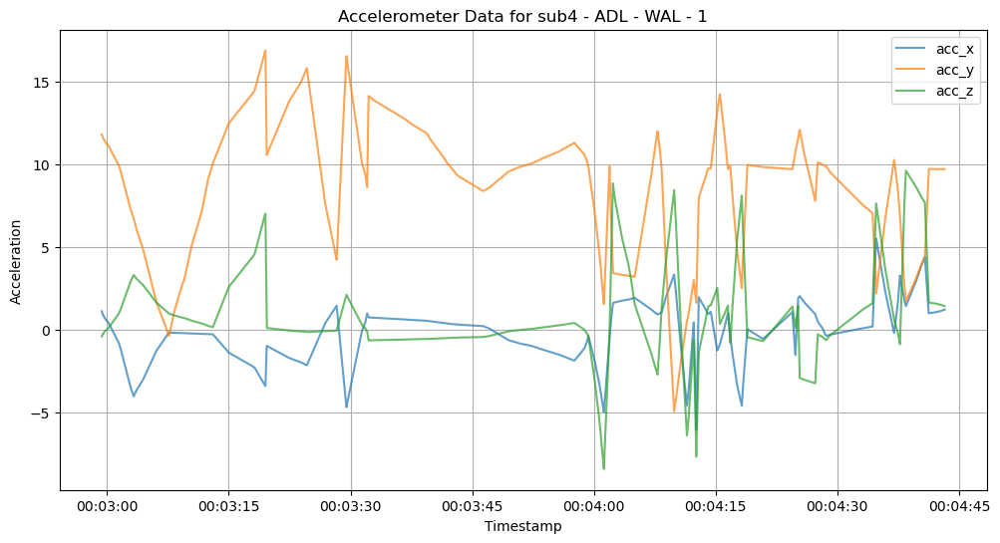

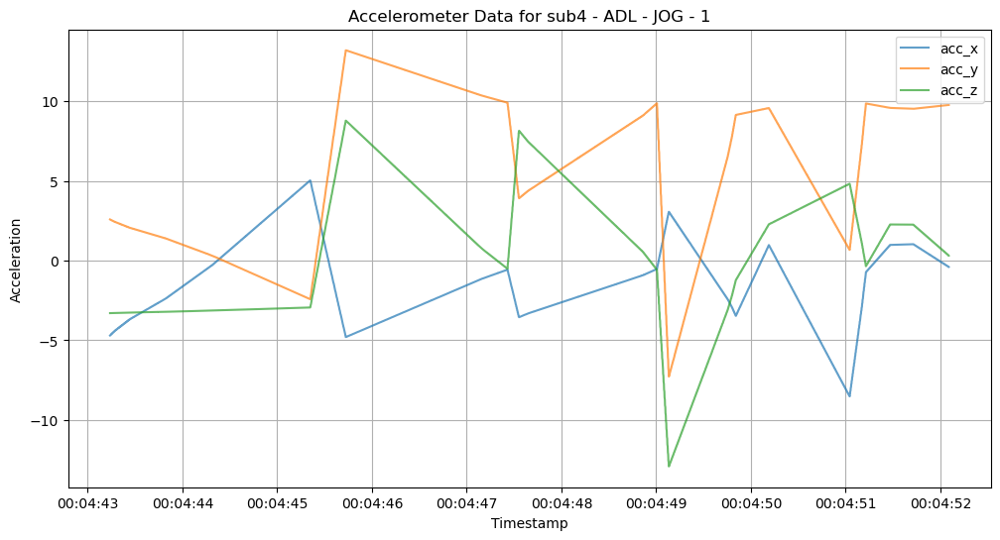

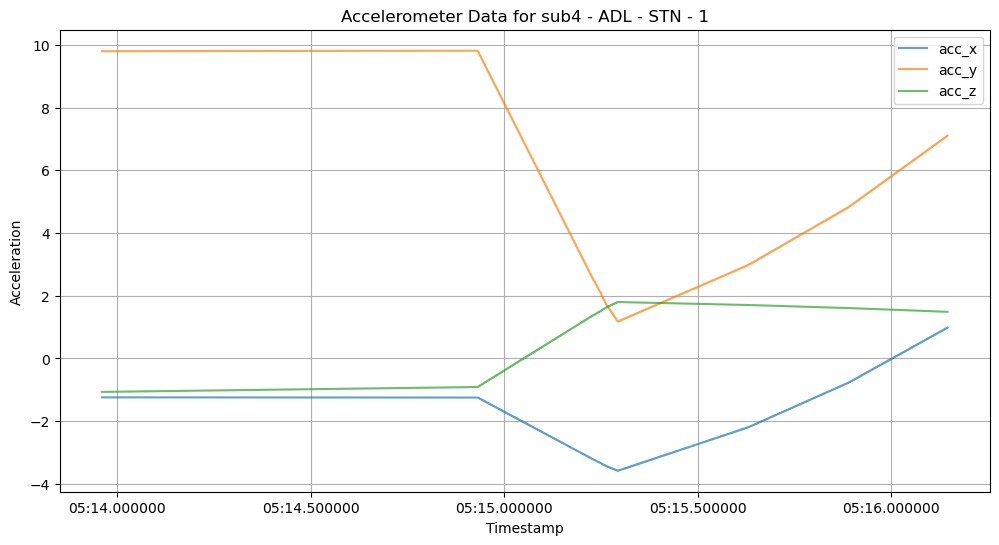

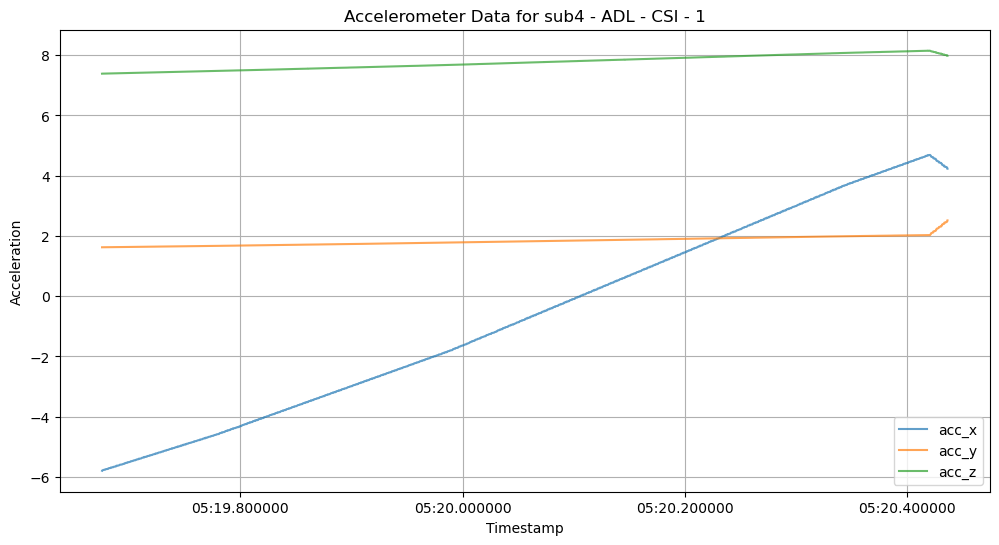

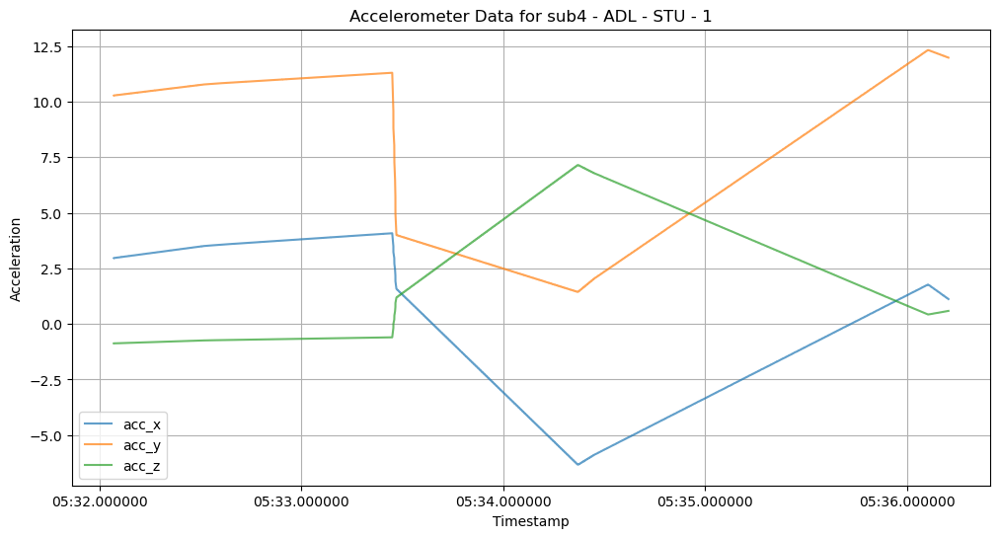

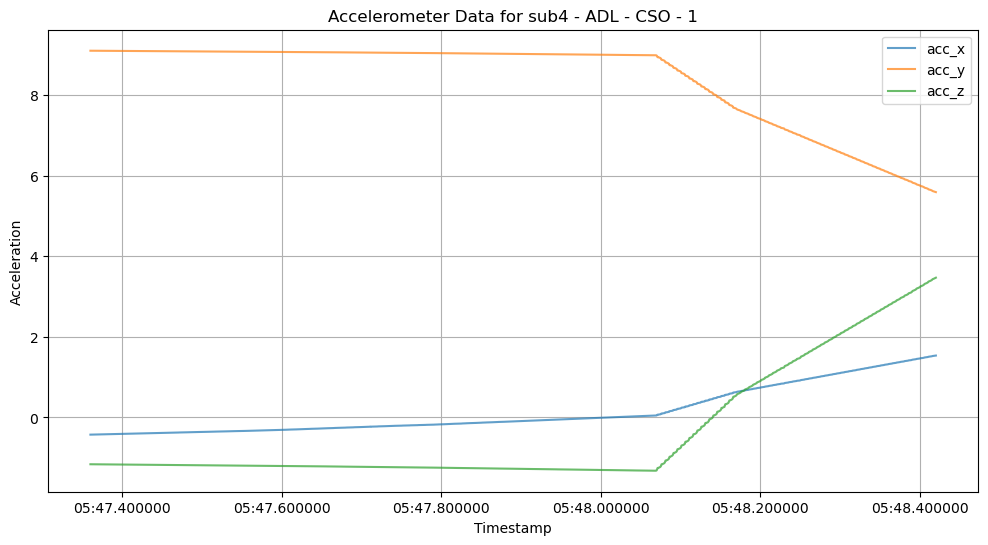

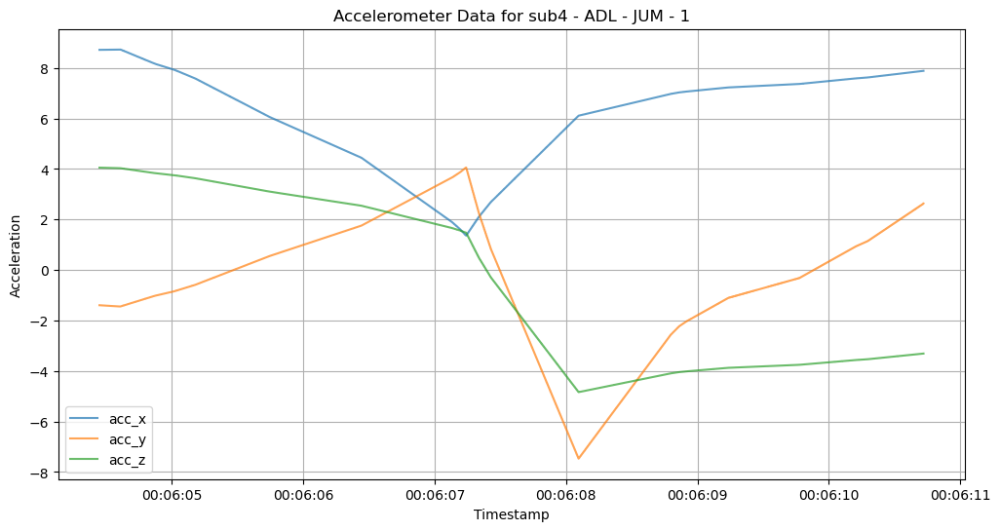

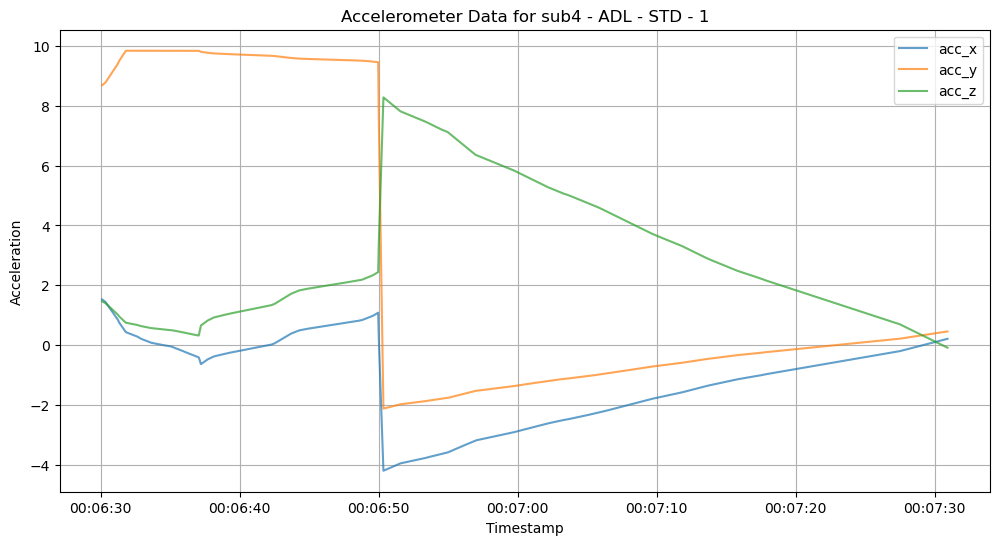

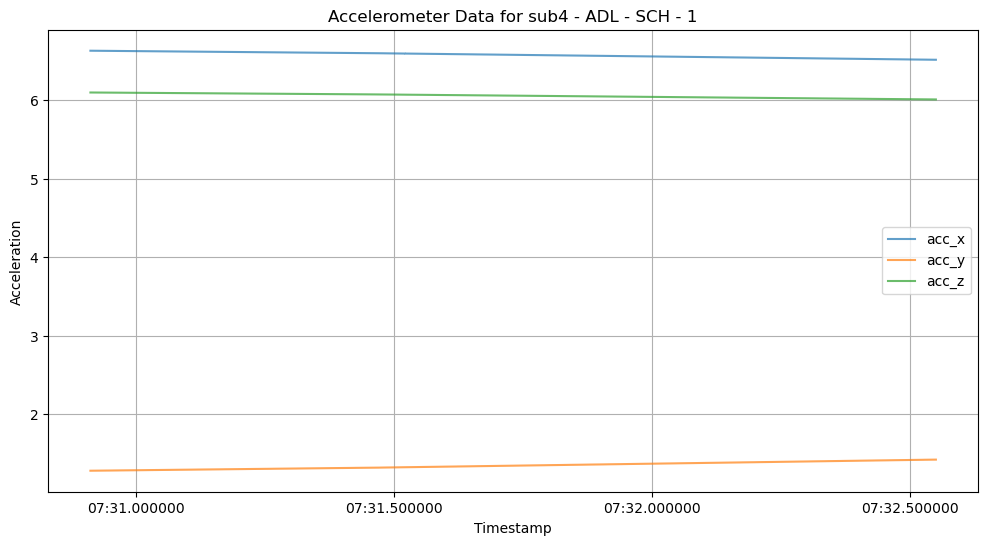

In [16]:
# Accelerometer data for subject4, 

for act in adl_df['activity'].unique():
    plot_accelerometer_data(df, subject="sub4", category="ADL", activity=act, trial=1)


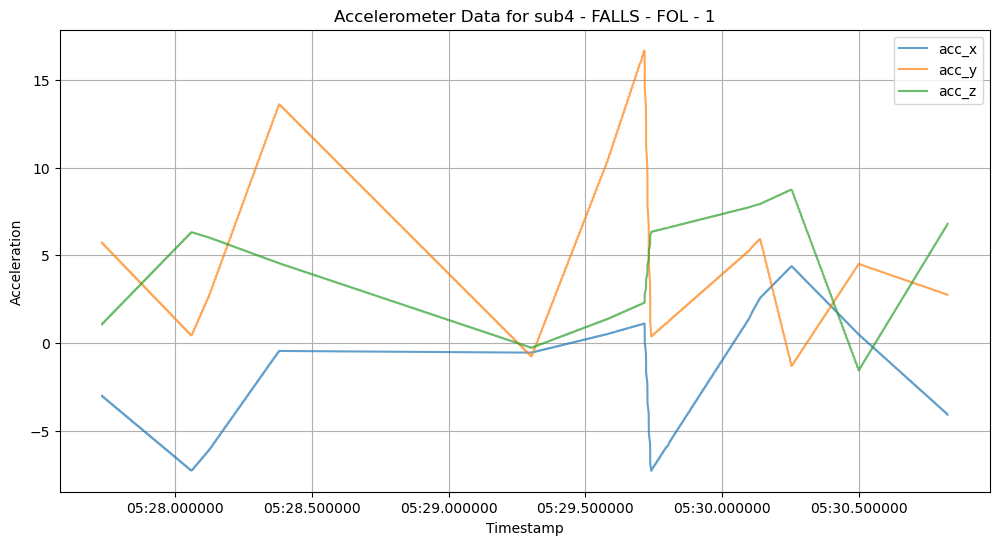

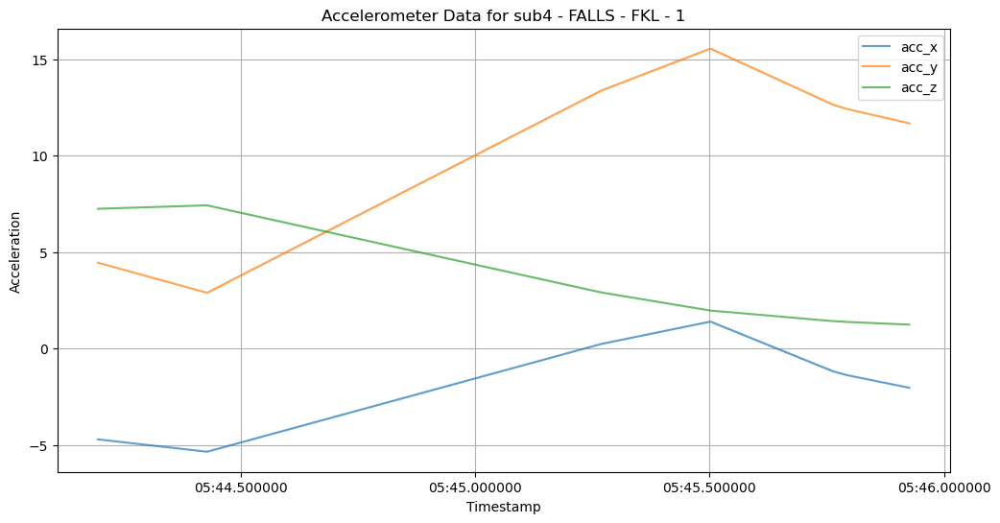

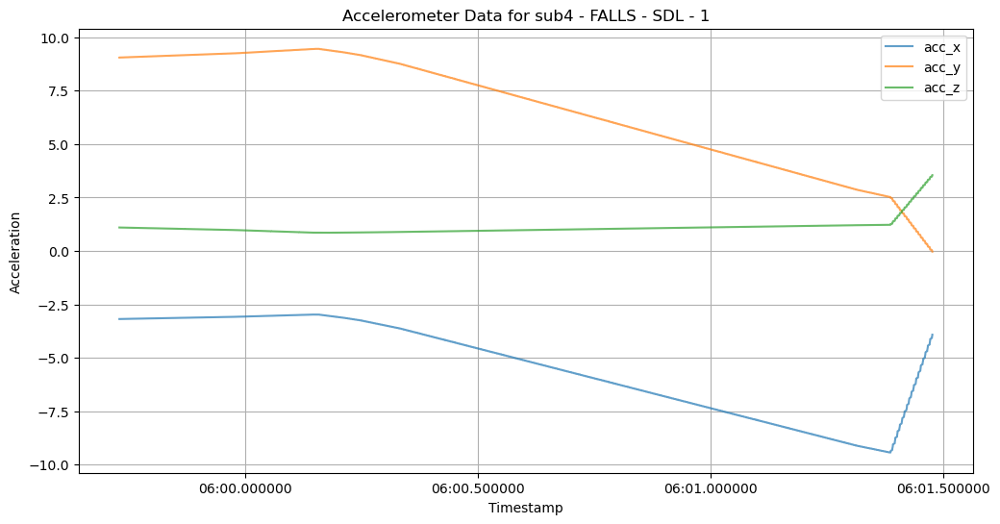

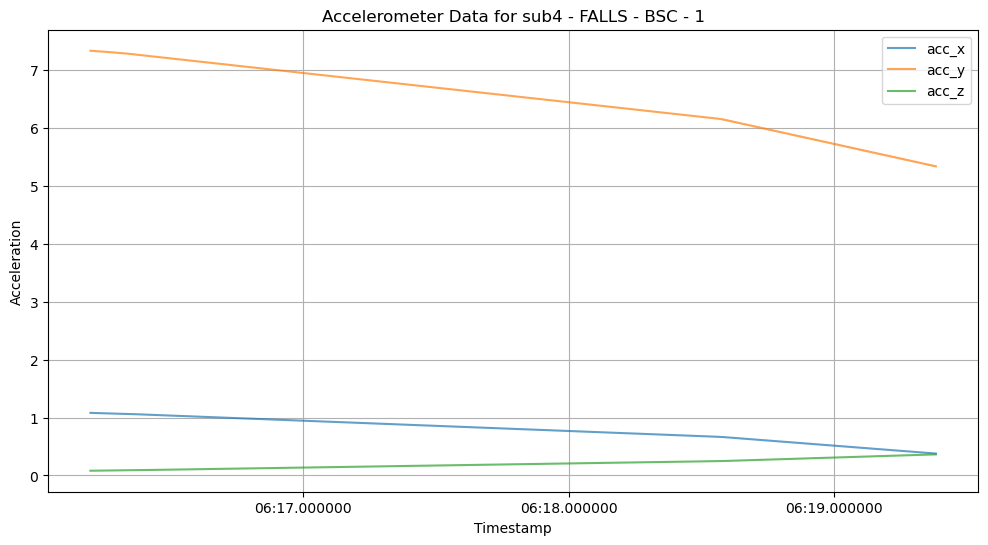

In [17]:
# Accelerometer data for subject4, 

for act in fall_df['activity'].unique():
    plot_accelerometer_data(df, subject="sub4", category="FALLS", activity=act, trial=1)


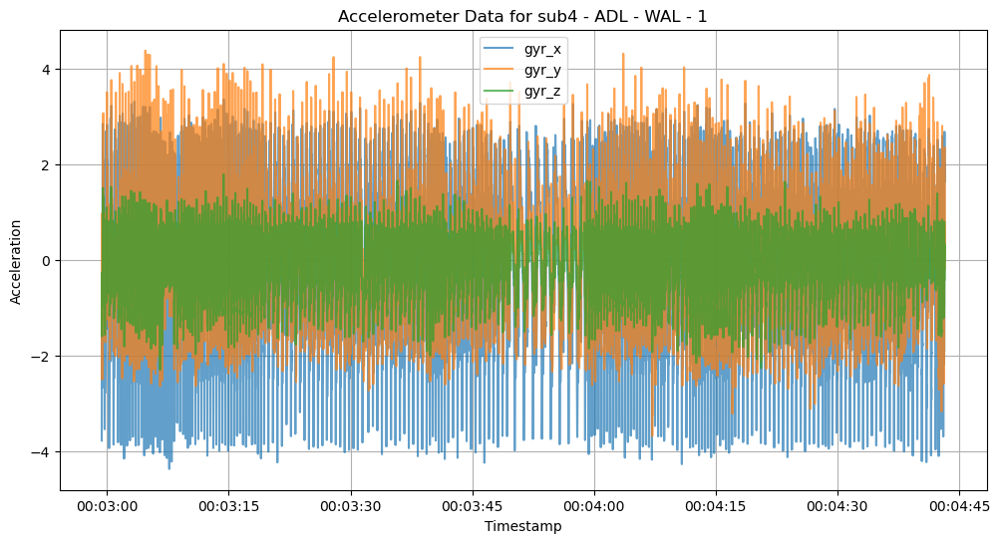

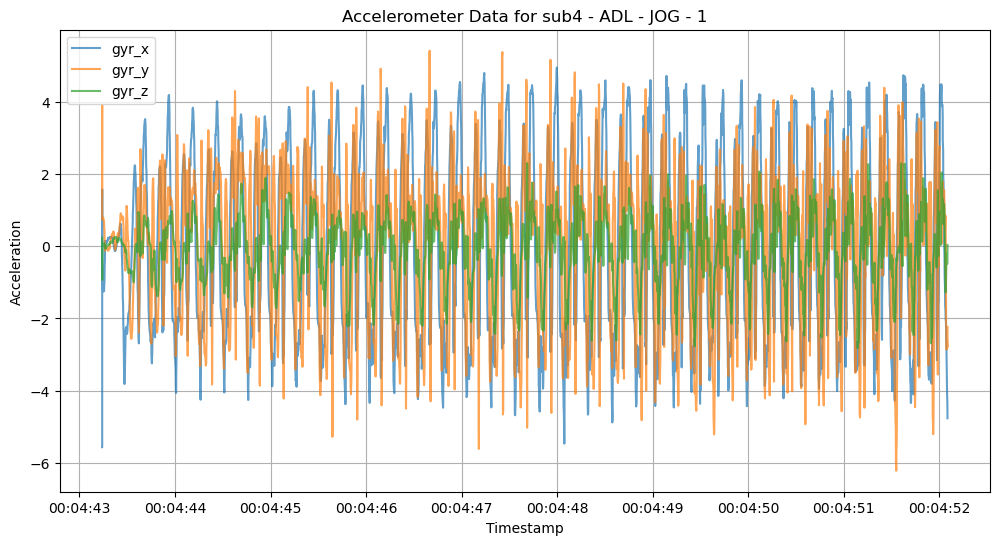

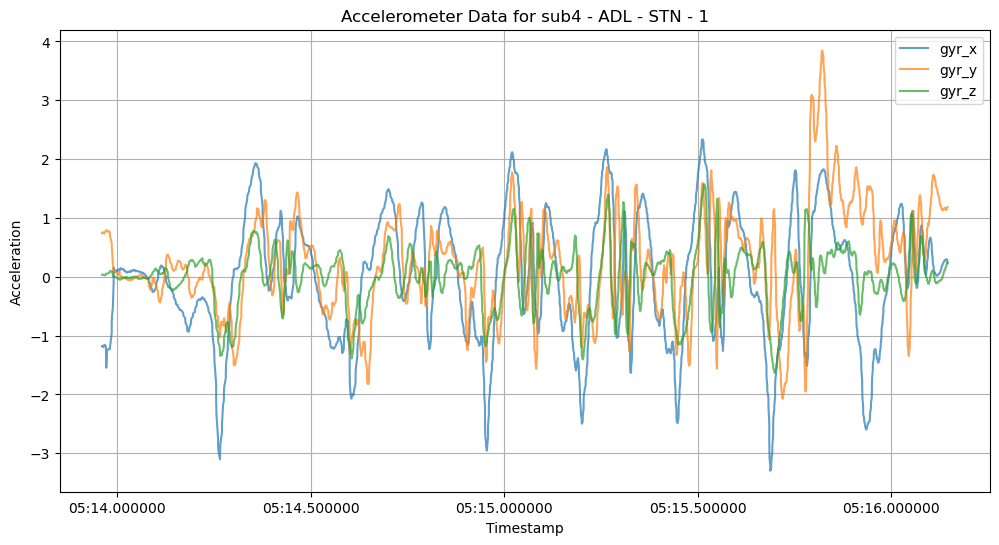

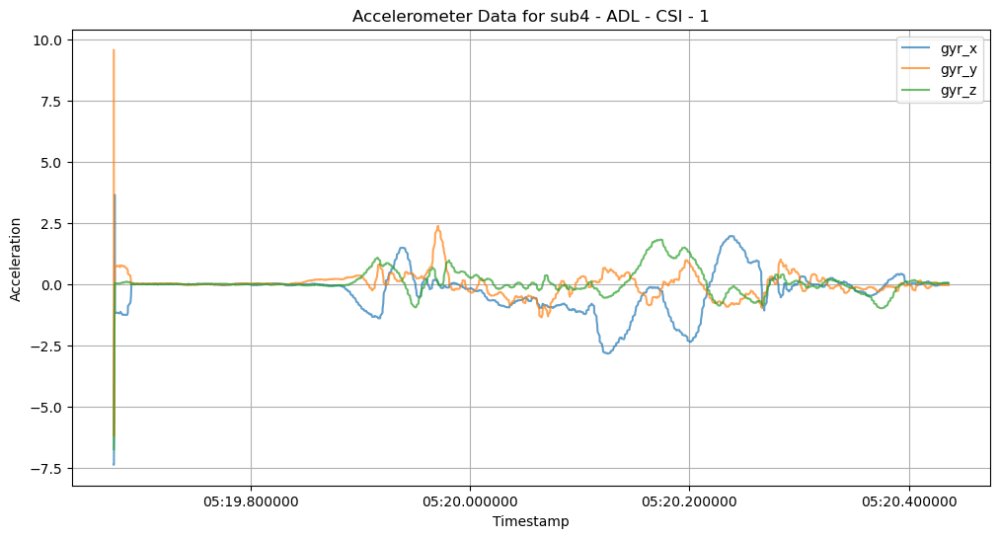

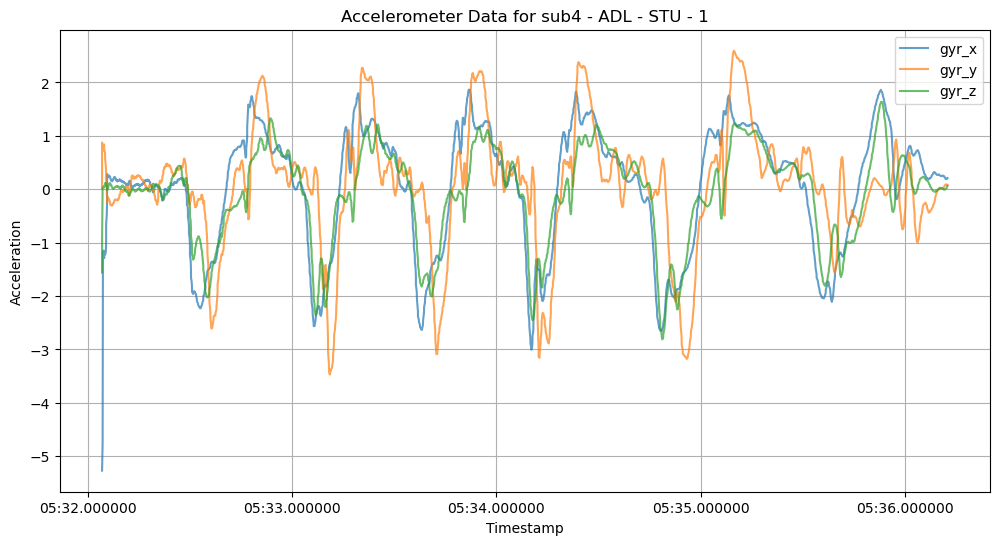

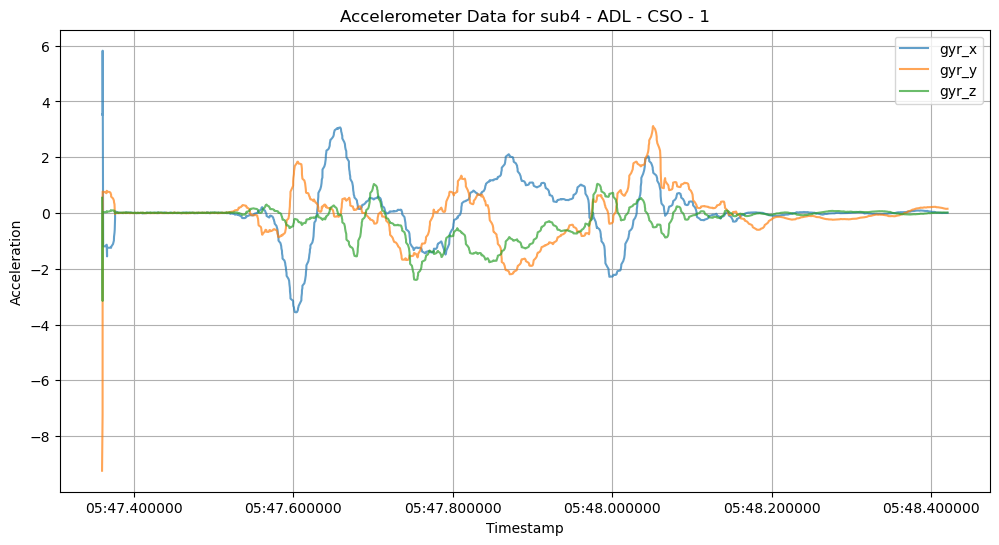

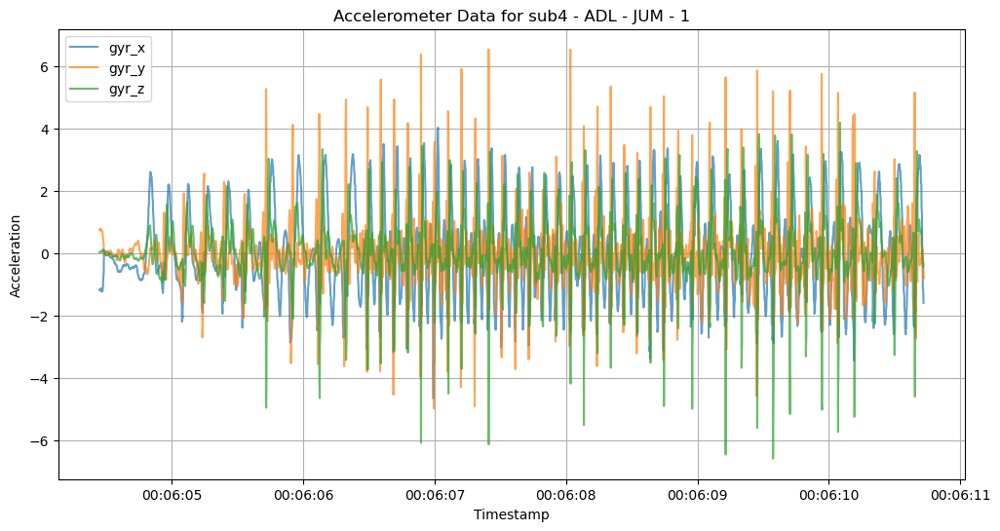

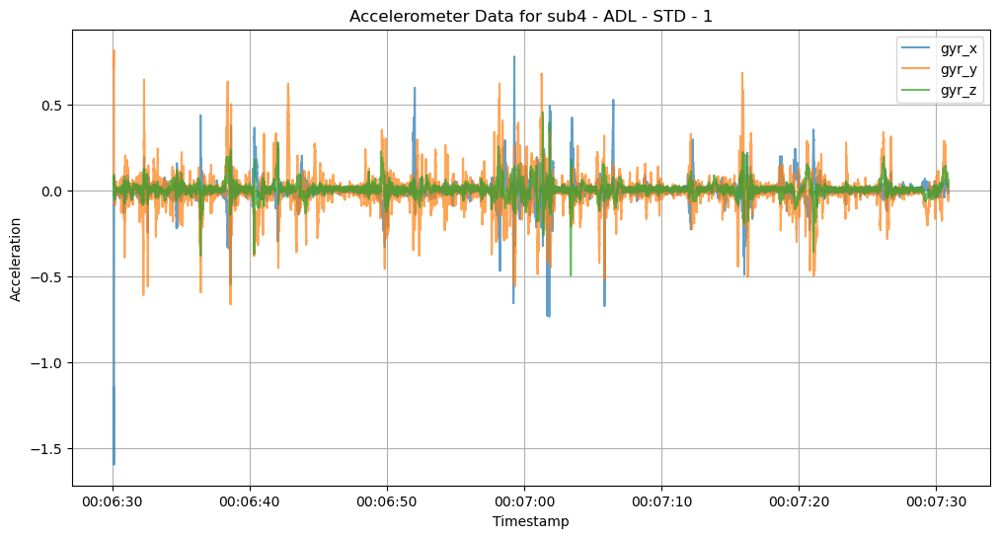

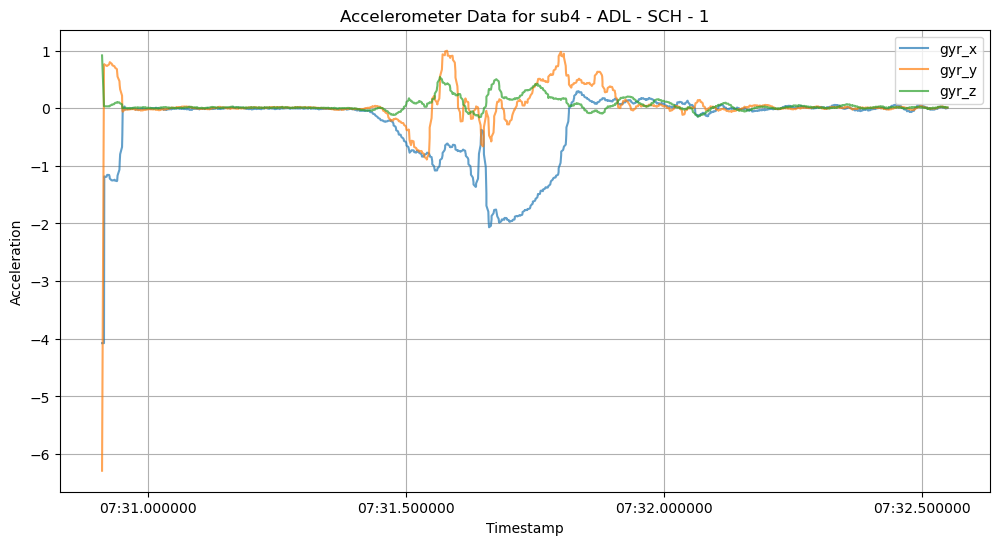

In [18]:
for act in adl_df['activity'].unique():
    plot_gyrometer_data(df, subject="sub4", category="ADL", activity=act, trial=1)

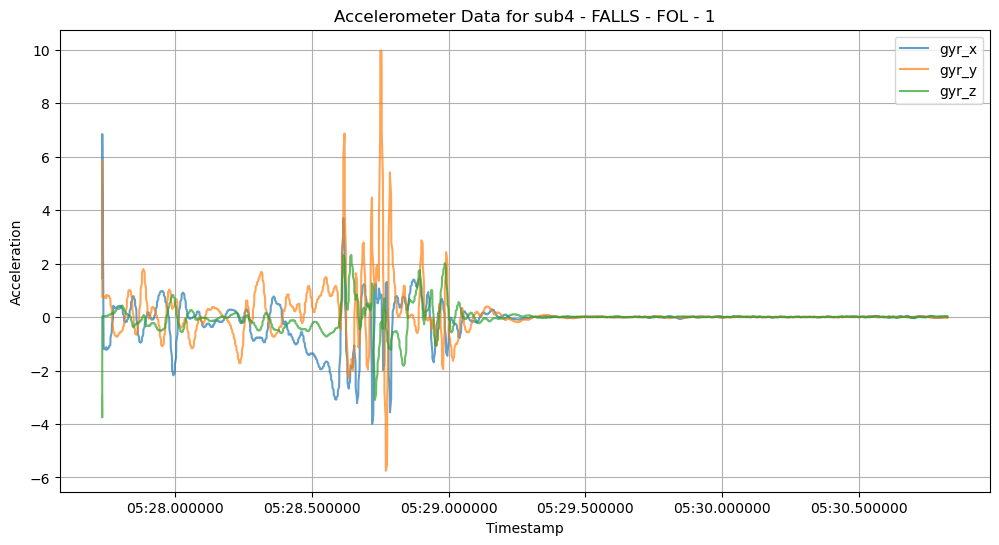

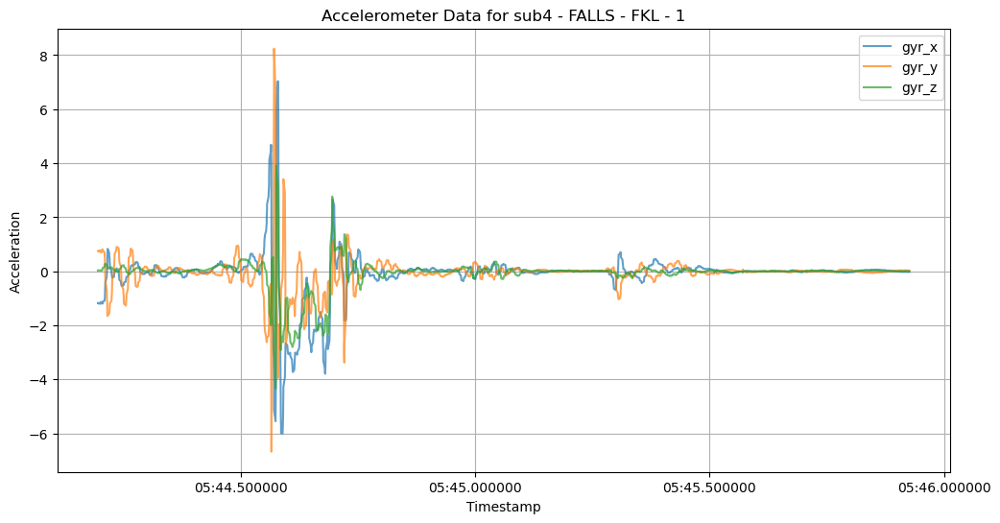

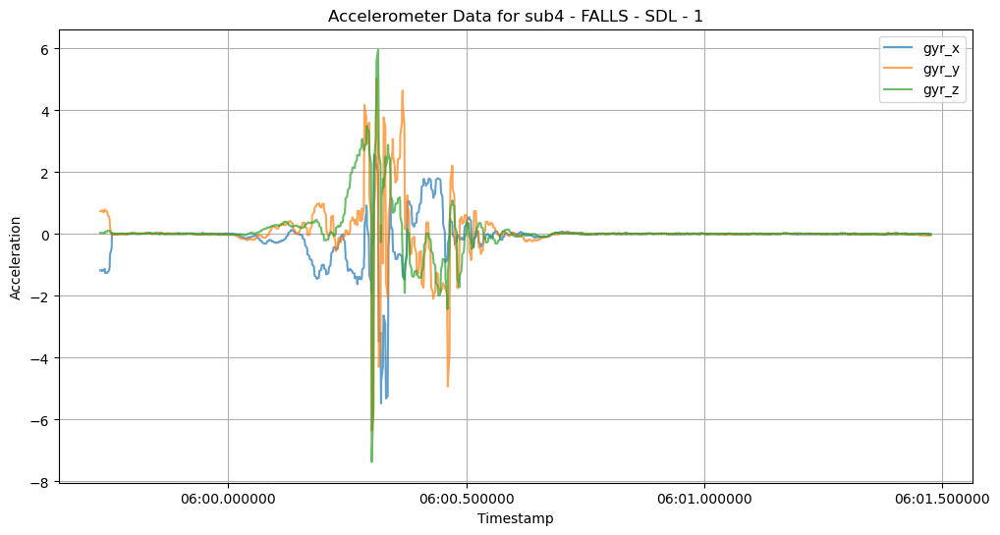

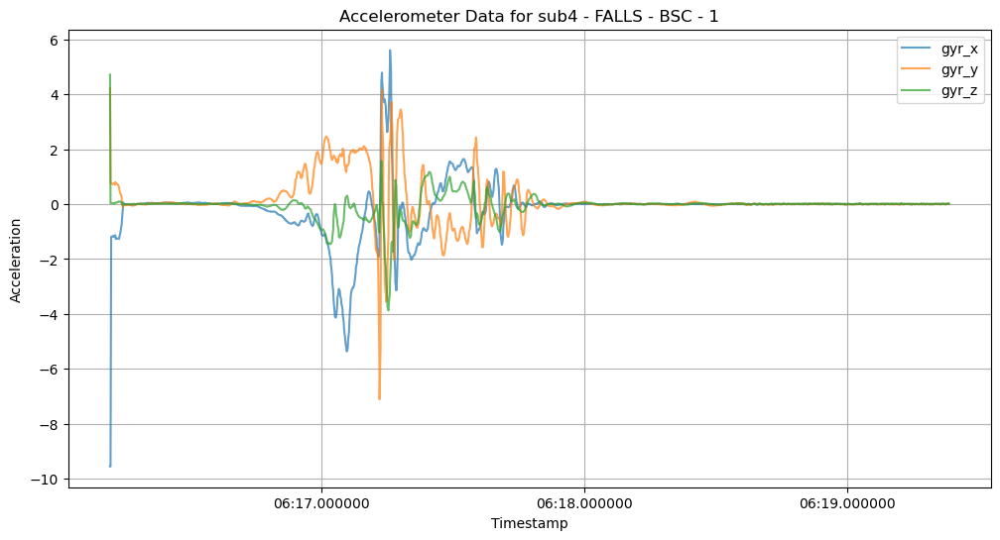

In [19]:
# Gyro for fall
for act in fall_df['activity'].unique():
    plot_gyrometer_data(df, subject="sub4", category="FALLS", activity=act, trial=1)

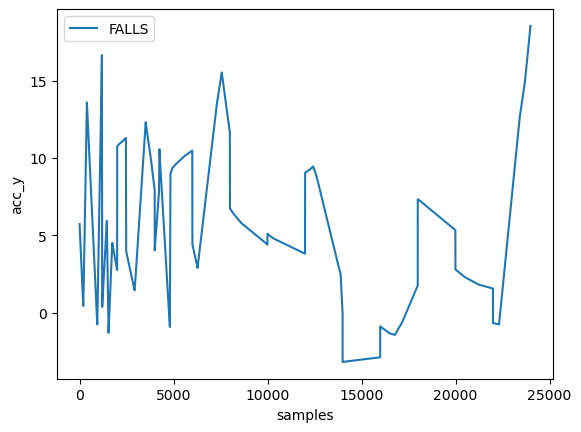

In [20]:
# Group by participant

category_df = df.query("category == 'FALLS'").query("subject == 'sub4'").reset_index()

fig, ax = plt.subplots()
category_df.groupby(['category'])["acc_y"].plot()
ax.set_ylabel("acc_y")
ax.set_xlabel("samples")
plt.legend()


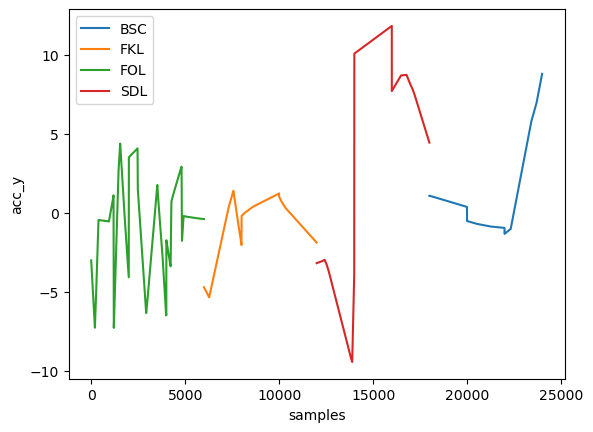

In [21]:
# Group by activity

fall_df = df.query("category == 'FALLS'").query("subject == 'sub4'").reset_index()

fig, ax = plt.subplots()
fall_df.groupby(['activity'])["acc_x"].plot()
ax.set_ylabel("acc_y")
ax.set_xlabel("samples")
plt.legend()


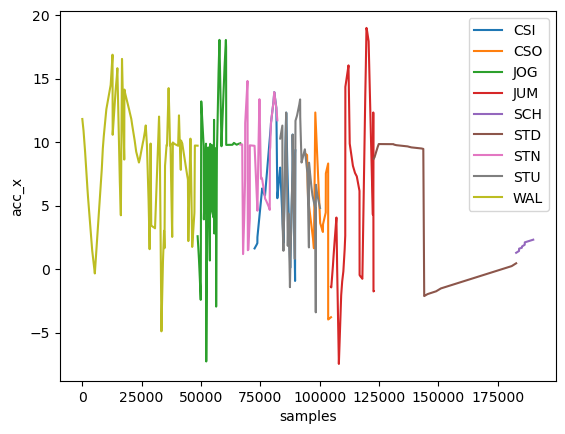

In [22]:
adl_df = df.query("category == 'ADL'").query("subject == 'sub4'").reset_index()

fig, ax = plt.subplots()
adl_df.groupby(['activity'])["acc_y"].plot()
ax.set_ylabel("acc_x")
ax.set_xlabel("samples")
plt.legend()


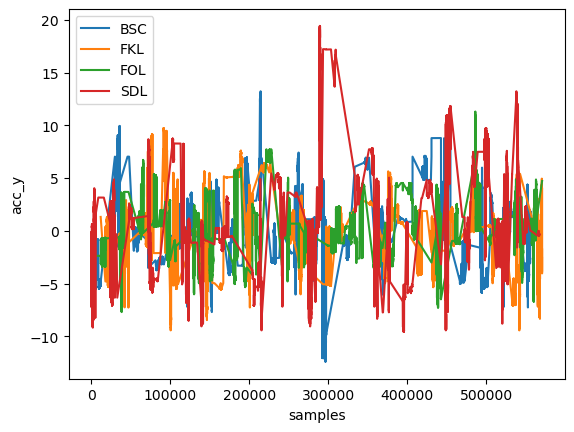

In [23]:
fall_df = df.query("category == 'FALLS'").sort_values('subject').reset_index()

fig, ax = plt.subplots()
fall_df.groupby(['activity'])["acc_x"].plot()
ax.set_ylabel("acc_y")
ax.set_xlabel("samples")
plt.legend()


Because the data is in nano seconds, it is too noisy for analysis

In [24]:
df

,acc_x,acc_y,acc_z,gyr_x,gyr_y,gyr_z,subject,trial,age,height,weight,gender,category,activity
timestamp,,,,,,,,,,,,,,
1970-01-01 00:02:59.346219,1.130063,11.817780,-0.383072,-3.768428,-0.953866,-0.553749,sub4,1,32,186,93,M,ADL,WAL
1970-01-01 00:02:59.349906,1.127694,11.815442,-0.381362,-3.628845,-0.895528,-0.386983,sub4,1,32,186,93,M,ADL,WAL
1970-01-01 00:02:59.350795,1.125325,11.813104,-0.379651,-3.474601,-0.706771,-0.308487,sub4,1,32,186,93,M,ADL,WAL
1970-01-01 00:02:59.351241,1.122956,11.810765,-0.377941,-3.318220,-0.344223,-0.295353,sub4,1,32,186,93,M,ADL,WAL
1970-01-01 00:02:59.354893,1.120587,11.808427,-0.376230,-3.174361,0.103236,-0.286801,sub4,1,32,186,93,M,ADL,WAL
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1970-01-01 02:55:05.189187,0.880756,9.149267,0.568708,-0.031154,0.024435,0.022297,sub30,3,47,172,90,M,FALLS,BSC
1970-01-01 02:55:05.194178,0.880466,9.148878,0.569163,-0.038179,0.017410,0.020159,sub30,3,47,172,90,M,FALLS,BSC
1970-01-01 02:55:05.199176,0.880176,9.148489,0.569617,-0.029627,0.021075,0.020769,sub30,3,47,172,90,M,FALLS,BSC


In [25]:
# Resample data into 5ms

sampling = {
    "acc_x": "mean",
    "acc_y": "mean",
    "acc_z": "mean",
    "gyr_x": "mean",
    "gyr_y": "mean",
    "gyr_z": "mean",
    "subject": "last",
    "trial": "last",
    "age": "last",
    "height": "last",
    "weight": "last",
    "gender": "last",
    "category": "last",
    "activity": "last",
}


df_resample = df.resample("5ms").apply(sampling)

In [26]:
df_resample

,acc_x,acc_y,acc_z,gyr_x,gyr_y,gyr_z,subject,trial,age,height,weight,gender,category,activity
timestamp,,,,,,,,,,,,,,
1970-01-01 00:02:59.345,1.128879,11.816611,-0.382217,-3.698636,-0.924697,-0.470366,sub4,1.0,32.0,186.0,93.0,M,ADL,WAL
1970-01-01 00:02:59.350,1.122956,11.810765,-0.377941,-3.322394,-0.315919,-0.296881,sub4,1.0,32.0,186.0,93.0,M,ADL,WAL
1970-01-01 00:02:59.355,1.115848,11.803751,-0.372809,-2.831971,0.639576,-0.275297,sub4,1.0,32.0,186.0,93.0,M,ADL,WAL
1970-01-01 00:02:59.360,1.108741,11.796736,-0.367677,-2.073175,0.901841,-0.672563,sub4,1.0,32.0,186.0,93.0,M,ADL,WAL
1970-01-01 00:02:59.365,1.101633,11.789721,-0.362545,-1.556790,0.074526,-1.240260,sub4,1.0,32.0,186.0,93.0,M,ADL,WAL
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1970-01-01 02:55:05.185,0.880756,9.149267,0.568708,-0.031154,0.024435,0.022297,sub30,3.0,47.0,172.0,90.0,M,FALLS,BSC
1970-01-01 02:55:05.190,0.880466,9.148878,0.569163,-0.038179,0.017410,0.020159,sub30,3.0,47.0,172.0,90.0,M,FALLS,BSC
1970-01-01 02:55:05.195,0.880176,9.148489,0.569617,-0.029627,0.021075,0.020769,sub30,3.0,47.0,172.0,90.0,M,FALLS,BSC


In [27]:
df_resample.describe()

,acc_x,acc_y,acc_z,gyr_x,gyr_y,gyr_z,trial,age,height,weight
count,1.340454e+06,1.340454e+06,1.340454e+06,1.340454e+06,1.340454e+06,1.340454e+06,1.340454e+06,1.340454e+06,1.340454e+06,1.340454e+06
mean,2.170066e-01,6.495795e+00,2.021370e+00,-1.964991e-02,1.304796e-03,-5.761031e-03,1.843475e+00,2.707499e+01,1.736545e+02,7.920846e+01
std,3.533156e+00,4.506783e+00,3.859590e+00,9.614423e-01,9.741968e-01,7.212416e-01,1.242908e+00,4.628900e+00,8.313954e+00,1.601140e+01
min,-1.242077e+01,-9.591936e+00,-1.291879e+01,-9.993755e+00,-1.000750e+01,-1.000597e+01,1.000000e+00,2.200000e+01,1.600000e+02,5.000000e+01
25%,-1.710596e+00,2.639733e+00,-6.571415e-01,-1.184060e-01,-1.435533e-01,-7.544186e-02,1.000000e+00,2.500000e+01,1.680000e+02,6.400000e+01
50%,7.752986e-02,7.086222e+00,1.515571e+00,-1.527163e-03,4.479678e-03,1.084286e-02,1.000000e+00,2.600000e+01,1.720000e+02,8.000000e+01
75%,2.141025e+00,9.808764e+00,5.176065e+00,1.734857e-01,1.696678e-01,1.045343e-01,3.000000e+00,2.700000e+01,1.830000e+02,9.300000e+01
max,1.941774e+01,1.898963e+01,1.813847e+01,9.995282e+00,1.000750e+01,1.000689e+01,6.000000e+00,4.700000e+01,1.890000e+02,1.030000e+02


In [28]:
fall_df = df_resample[df_resample['category'] == 'FALLS']
adl_df = df_resample[df_resample['category'] == 'ADL']

In [29]:
fall_df

,acc_x,acc_y,acc_z,gyr_x,gyr_y,gyr_z,subject,trial,age,height,weight,gender,category,activity
timestamp,,,,,,,,,,,,,,
1970-01-01 00:05:27.735,-3.025778,5.700464,1.088912,3.252959,3.942932,-2.225280,sub4,1.0,32.0,186.0,93.0,M,FALLS,FOL
1970-01-01 00:05:27.740,-3.091001,5.619496,1.169154,-1.182024,0.764498,0.033801,sub4,1.0,32.0,186.0,93.0,M,FALLS,FOL
1970-01-01 00:05:27.745,-3.156225,5.538529,1.249396,-1.187929,0.739758,0.030645,sub4,1.0,32.0,186.0,93.0,M,FALLS,FOL
1970-01-01 00:05:27.750,-3.222899,5.455762,1.331421,-1.163495,0.778955,0.040419,sub4,1.0,32.0,186.0,93.0,M,FALLS,FOL
1970-01-01 00:05:27.755,-3.286673,5.376594,1.409880,-1.187726,0.813367,0.051720,sub4,1.0,32.0,186.0,93.0,M,FALLS,FOL
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1970-01-01 02:55:05.185,0.880756,9.149267,0.568708,-0.031154,0.024435,0.022297,sub30,3.0,47.0,172.0,90.0,M,FALLS,BSC
1970-01-01 02:55:05.190,0.880466,9.148878,0.569163,-0.038179,0.017410,0.020159,sub30,3.0,47.0,172.0,90.0,M,FALLS,BSC
1970-01-01 02:55:05.195,0.880176,9.148489,0.569617,-0.029627,0.021075,0.020769,sub30,3.0,47.0,172.0,90.0,M,FALLS,BSC


In [30]:
adl_df

,acc_x,acc_y,acc_z,gyr_x,gyr_y,gyr_z,subject,trial,age,height,weight,gender,category,activity
timestamp,,,,,,,,,,,,,,
1970-01-01 00:02:59.345,1.128879,11.816611,-0.382217,-3.698636,-0.924697,-0.470366,sub4,1.0,32.0,186.0,93.0,M,ADL,WAL
1970-01-01 00:02:59.350,1.122956,11.810765,-0.377941,-3.322394,-0.315919,-0.296881,sub4,1.0,32.0,186.0,93.0,M,ADL,WAL
1970-01-01 00:02:59.355,1.115848,11.803751,-0.372809,-2.831971,0.639576,-0.275297,sub4,1.0,32.0,186.0,93.0,M,ADL,WAL
1970-01-01 00:02:59.360,1.108741,11.796736,-0.367677,-2.073175,0.901841,-0.672563,sub4,1.0,32.0,186.0,93.0,M,ADL,WAL
1970-01-01 00:02:59.365,1.101633,11.789721,-0.362545,-1.556790,0.074526,-1.240260,sub4,1.0,32.0,186.0,93.0,M,ADL,WAL
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1970-01-01 02:32:56.295,3.605704,5.003637,3.772871,0.050091,-0.019548,0.057727,sub8,6.0,22.0,183.0,93.0,M,ADL,CSO
1970-01-01 02:32:56.300,3.605656,5.003696,3.772834,0.036346,-0.012217,0.050091,sub8,6.0,22.0,183.0,93.0,M,ADL,CSO
1970-01-01 02:32:56.305,3.605608,5.003755,3.772797,0.036652,0.002443,0.040317,sub8,6.0,22.0,183.0,93.0,M,ADL,CSO


In [31]:
# Set graph for best resolution
mpl.style.use("seaborn-v0_8-deep")
mpl.rcParams["figure.figsize"] = (20,5)
mpl.rcParams["figure.dpi"] = 100
import numpy as np
mpl.rcParams['axes.prop_cycle'] = plt.cycler(color=plt.cm.get_cmap("gist_ncar", 30)(np.linspace(0, 1, 30)))


C:\Users\sovan\AppData\Local\Temp\ipykernel_13356\2912340227.py:6: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  mpl.rcParams['axes.prop_cycle'] = plt.cycler(color=plt.cm.get_cmap("gist_ncar", 30)(np.linspace(0, 1, 30)))


In [32]:
trial_df = df_resample[df_resample['trial'] == 6]

In [33]:
trial_df['subject'].value_counts()

subject
sub8     7595
sub10    7533
sub11    7464
sub5     5120
sub9     3051
sub3     2804
sub2     2097
sub7     1773
sub4     1145
Name: count, dtype: int64

In [34]:
fall_df['activity'].unique()

array(['FOL', 'FKL', 'SDL', 'BSC'], dtype=object)

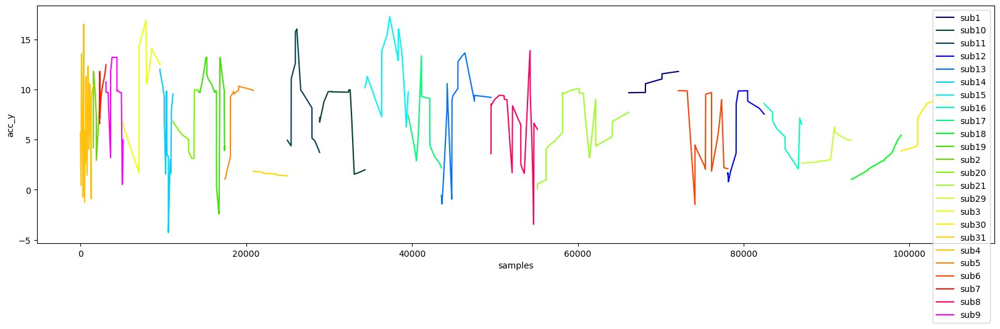

In [35]:
# Analyze Front Fall

category_df = df_resample.query("category == 'FALLS'").query("activity == 'FOL'").reset_index()

fig,ax = plt.subplots()
category_df.groupby(["subject"])["acc_y"].plot()
ax.set_ylabel("acc_y")
ax.set_xlabel("samples")
plt.legend()



### Overview of FALL vs ADL

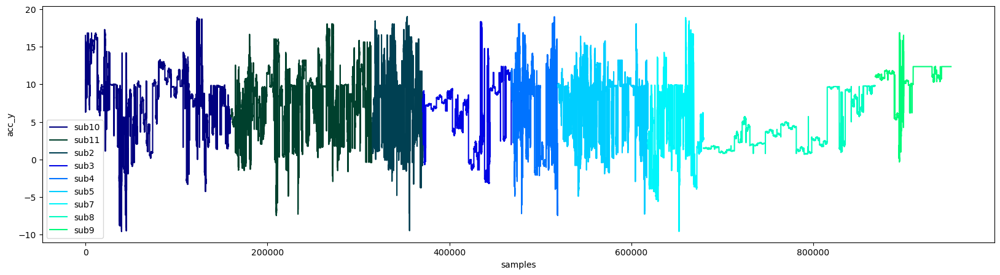

In [36]:
## Acc_y

category_df = df_resample.query("category == 'ADL'").sort_values("subject").reset_index()

fig,ax = plt.subplots()
category_df.groupby(["subject"])["acc_y"].plot()
ax.set_ylabel("acc_y")
ax.set_xlabel("samples")
plt.legend()

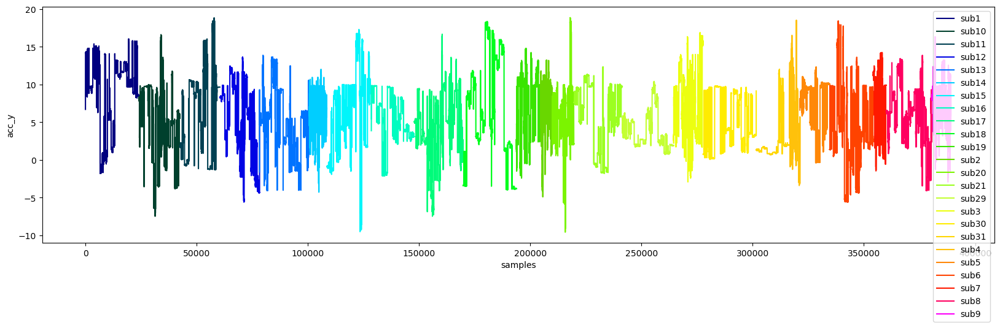

In [37]:
category_df = df_resample.query("category == 'FALLS'").sort_values("subject").reset_index()

fig,ax = plt.subplots()
category_df.groupby(["subject"])["acc_y"].plot()
ax.set_ylabel("acc_y")
ax.set_xlabel("samples")
plt.legend()

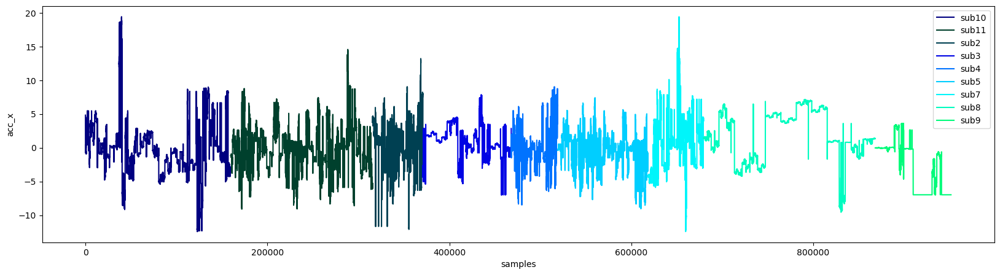

In [38]:
# acc_x

category_df = df_resample.query("category == 'ADL'").sort_values("subject").reset_index()

fig,ax = plt.subplots()
category_df.groupby(["subject"])["acc_x"].plot()
ax.set_ylabel("acc_x")
ax.set_xlabel("samples")
plt.legend()

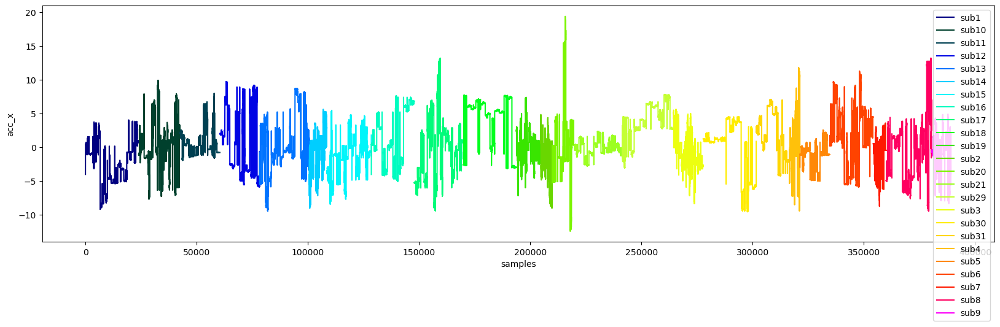

In [39]:
category_df = df_resample.query("category == 'FALLS'").sort_values("subject").reset_index()

fig,ax = plt.subplots()
category_df.groupby(["subject"])["acc_x"].plot()
ax.set_ylabel("acc_x")
ax.set_xlabel("samples")
plt.legend()

In [40]:
df_resample['activity'].unique()

array(['WAL', 'JOG', 'STN', 'CSI', 'FOL', 'STU', 'FKL', 'CSO', 'SDL',
       'JUM', 'BSC', 'STD', 'SCH', None], dtype=object)

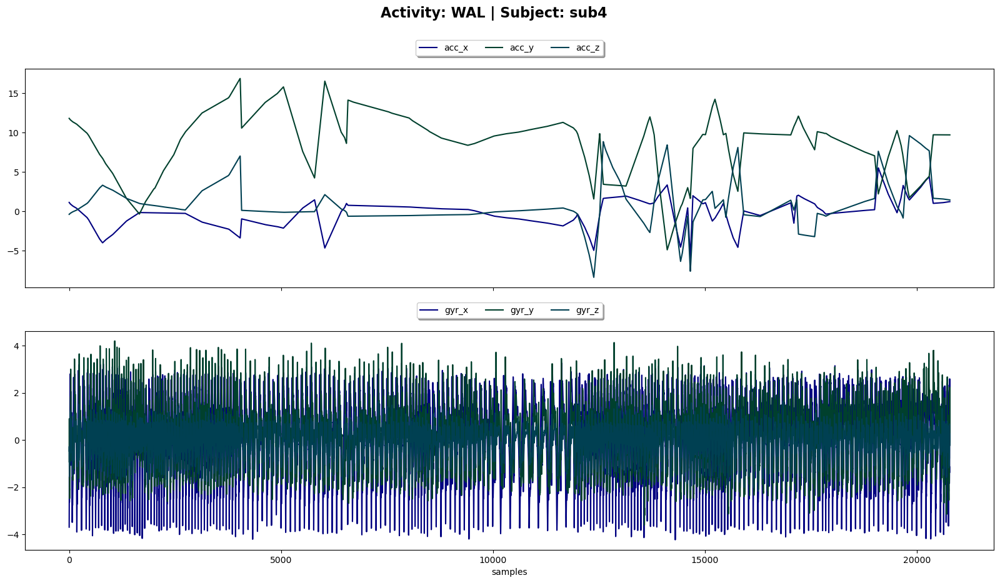

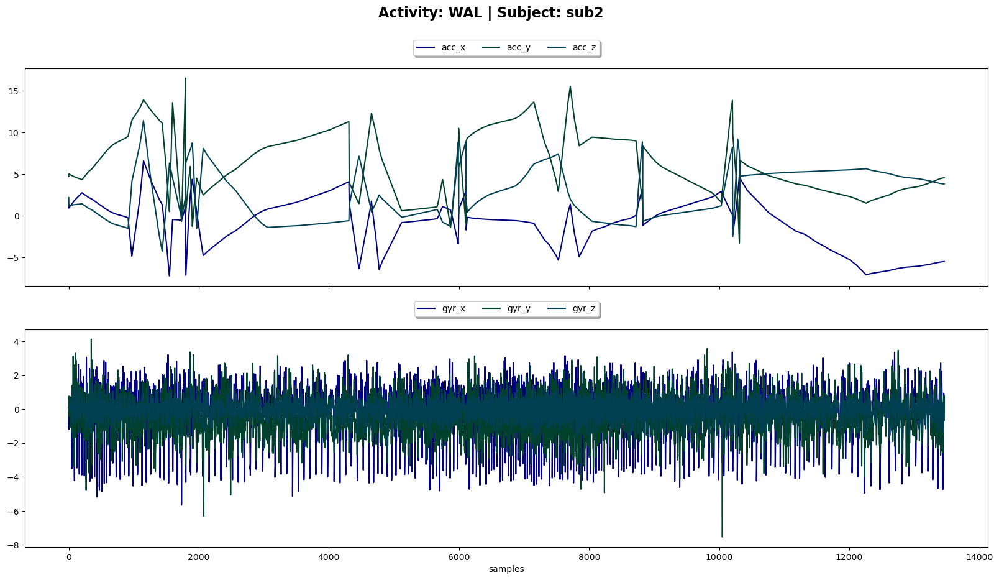

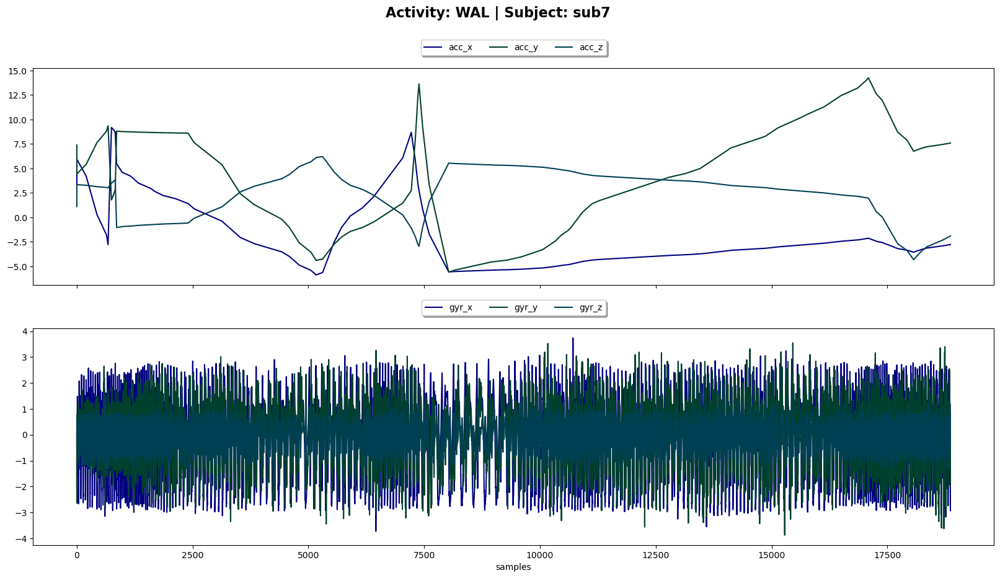

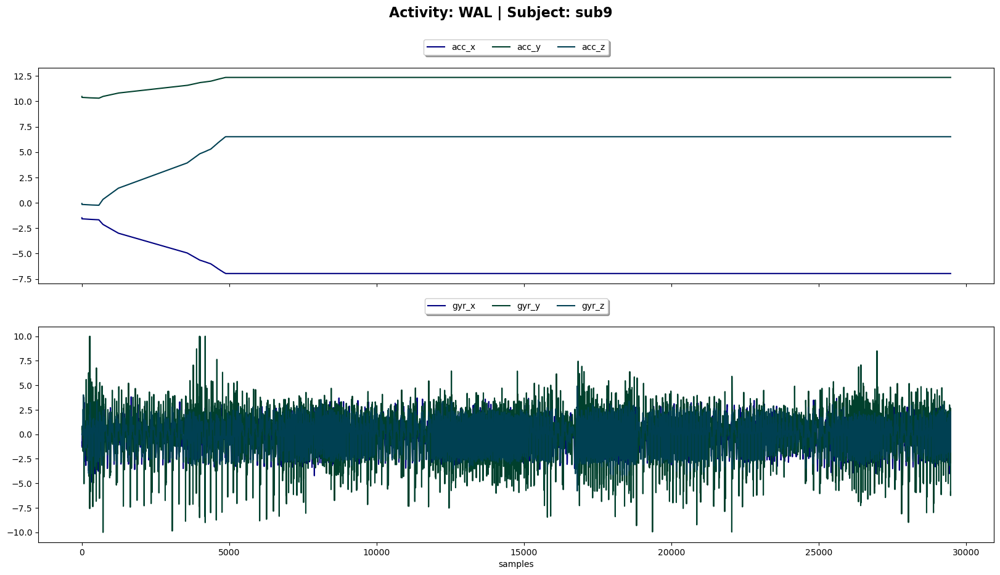

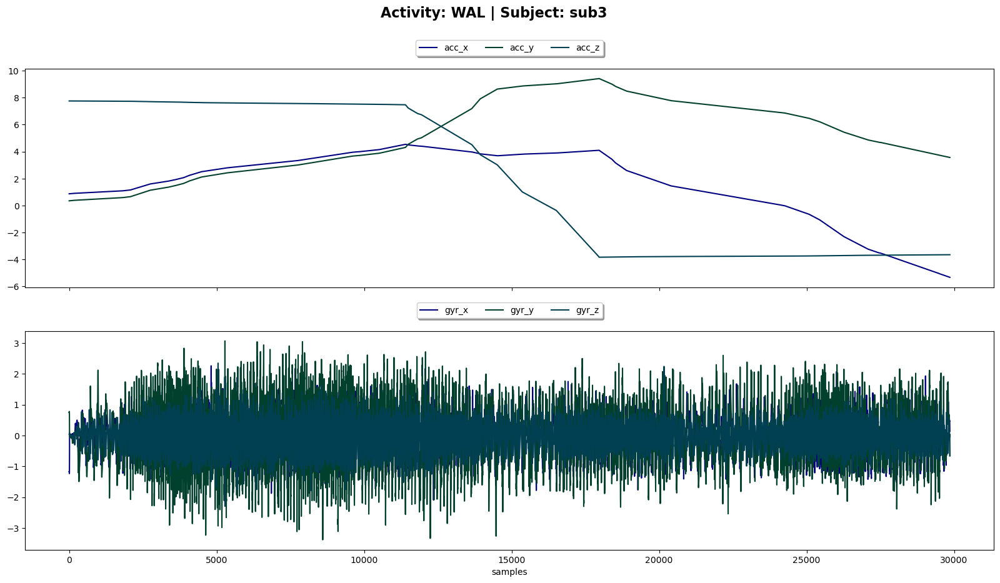

...

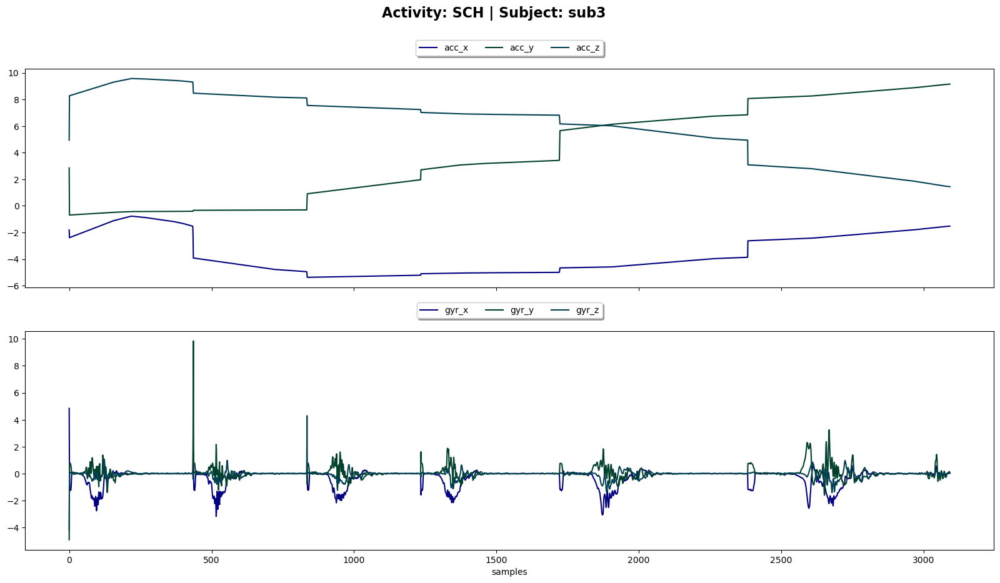

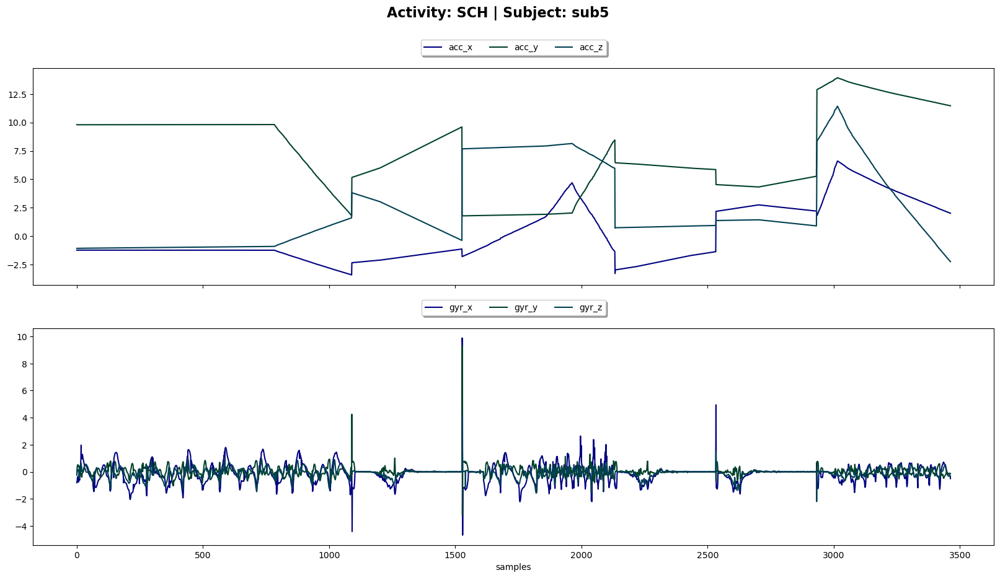

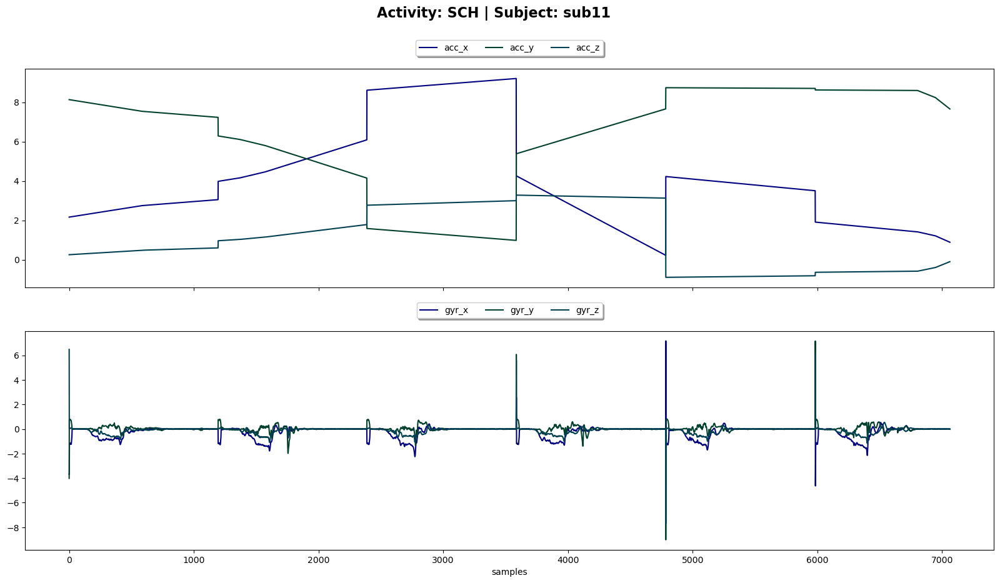

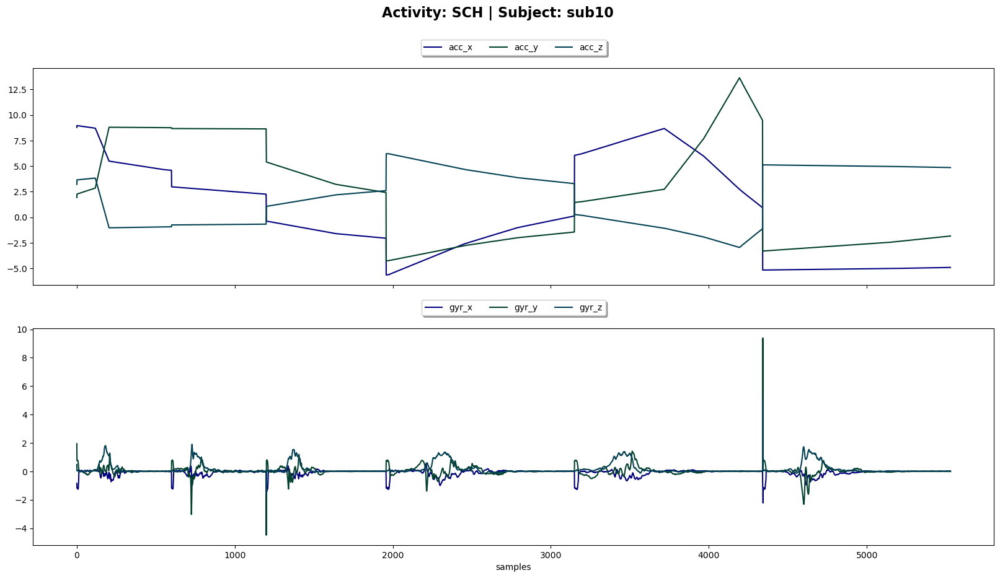

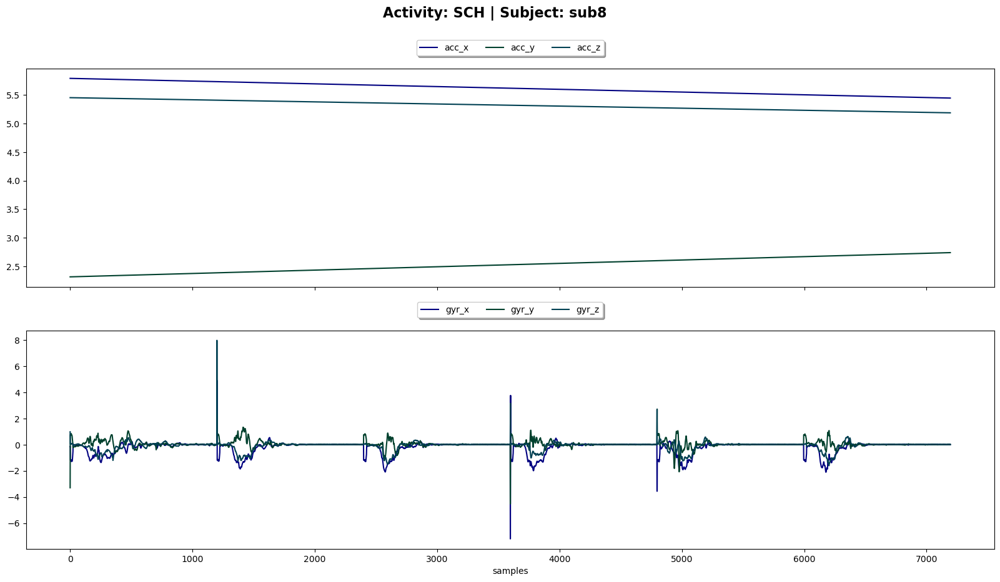

In [41]:
activites = df_resample['activity'].unique()
subjects = df_resample['subject'].unique()

for activity in activites:
    for subject in subjects:
        all_axis_df = (
            df_resample.query(f"activity=='{activity}'")
            .query(f"subject =='{subject}'")
            .reset_index()
        )
        
        if len(all_axis_df) > 0:
        
            fig, ax = plt.subplots(nrows=2, sharex=True, figsize=(20,10))
            all_axis_df[["acc_x", "acc_y", "acc_z"]].plot(ax=ax[0])
            all_axis_df[["gyr_x", "gyr_y", "gyr_z"]].plot(ax=ax[1])
            
            ax[0].legend(
                loc="upper center", bbox_to_anchor=(0.5, 1.15), ncol=3, fancybox=True, shadow=True
            )
            ax[1].legend(
                loc="upper center", bbox_to_anchor=(0.5, 1.15), ncol=3, fancybox=True, shadow=True
            )
            ax[1].set_xlabel("samples")
            
            # **Add Title Corresponding to Activity and Subject**
            fig.suptitle(f"Activity: {activity} | Subject: {subject}", fontsize=16, fontweight="bold")
            plt.show()
    
        